In [1]:
import os
import glob
import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
from tqdm import tqdm
%matplotlib inline
# import matplotlib

# matplotlib.rcParams['font.family'] ='Malgun Gothic'

# matplotlib.rcParams['axes.unicode_minus'] = False

In [2]:
# 원본 데이터 경로
man_original_data_path = '/home/jabblee/Desktop/CRC_collections/CRC_update/2023_Gatherings/2023_Gathering_m/Original/'
woman_original_data_path = '/home/jabblee/Desktop/CRC_collections/CRC_update/2023_Gatherings/2023_Gathering_w/Original/'

# 라벨링 데이터 경로
man_label_data_path = '/home/jabblee/Desktop/CRC_collections/CRC_update/2023_Gatherings/2023_Gathering_m/Labeling/'
woman_label_data_path = '/home/jabblee/Desktop/CRC_collections/CRC_update/2023_Gatherings/2023_Gathering_w/Labeling/'

# 원본 데이터
man_original_data_lst = sorted(glob.glob(man_original_data_path + '*', recursive = True))
woman_original_data_lst = sorted(glob.glob(woman_label_data_path + '*', recursive = True))

# 라벨링 데이터
man_label_data_lst = sorted(glob.glob(man_label_data_path + '*', recursive = True))
woman_label_data_lst = sorted(glob.glob(woman_label_data_path + '*', recursive = True))
total_label_datas_lst = sorted(man_label_data_lst + woman_label_data_lst)
print(len(total_label_datas_lst))

12


0it [00:00, ?it/s]

/home/jabblee/anaconda3/envs/AI/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/jabblee/anaconda3/envs/AI/lib/python3.7/site-packages/ipykernel_launcher.py:123: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
1it [00:21, 21.27s/it]

2it [00:43, 22.03s/it]

3it [01:06, 22.22s/it]

4it [01:27, 21.67s/it]

5it [01:50, 22.26s/it]

6it [02:15, 22.52s/it]
/home/jabblee/anaconda3/envs/AI/lib/python3.7/site-packages/ipykernel_launcher.py:128: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



Total valid data ndarray Shape : (6, 22, 8)


0it [00:00, ?it/s]/home/jabblee/anaconda3/envs/AI/lib/python3.7/site-packages/ipykernel_launcher.py:223: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
1it [00:24, 24.76s/it]

2it [00:50, 25.10s/it]

3it [01:07, 21.60s/it]

4it [01:33, 23.49s/it]

5it [01:56, 23.00s/it]

6it [02:26, 24.42s/it]


Total valid data ndarray Shape : (6, 22, 8)
Minimum cost of total_minimum_lst : [1329.0, 3483.0, 1227.0, 1820.0, 1515.0]
total_min_arr Shape : (264, 5)



/home/jabblee/anaconda3/envs/AI/lib/python3.7/site-packages/ipykernel_launcher.py:228: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


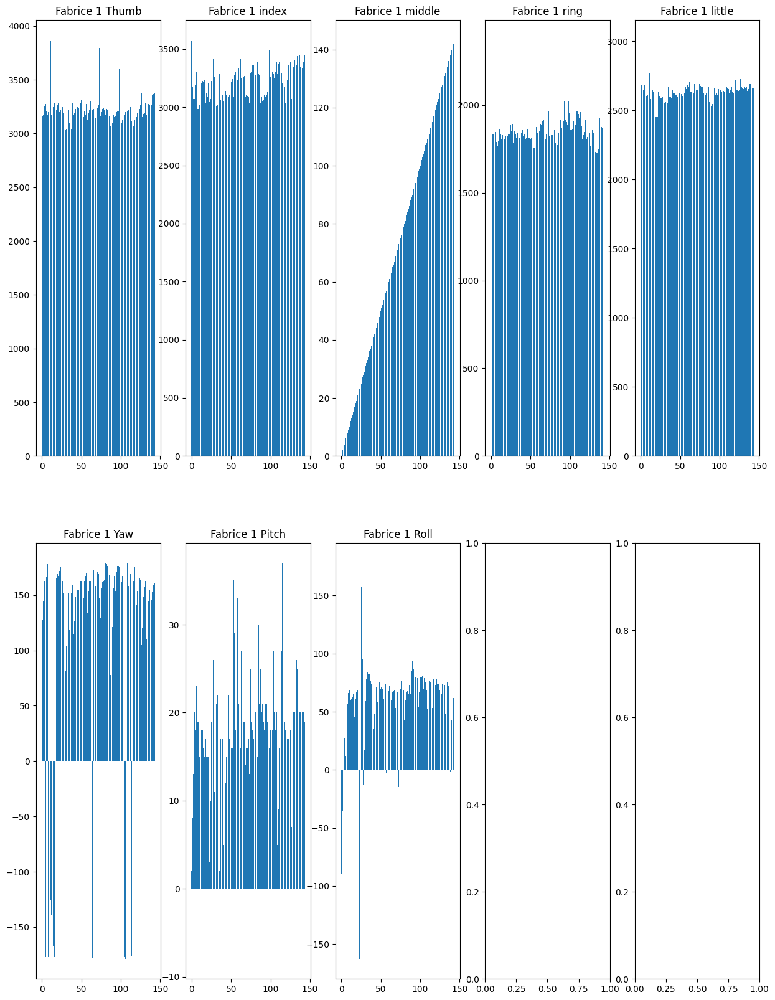

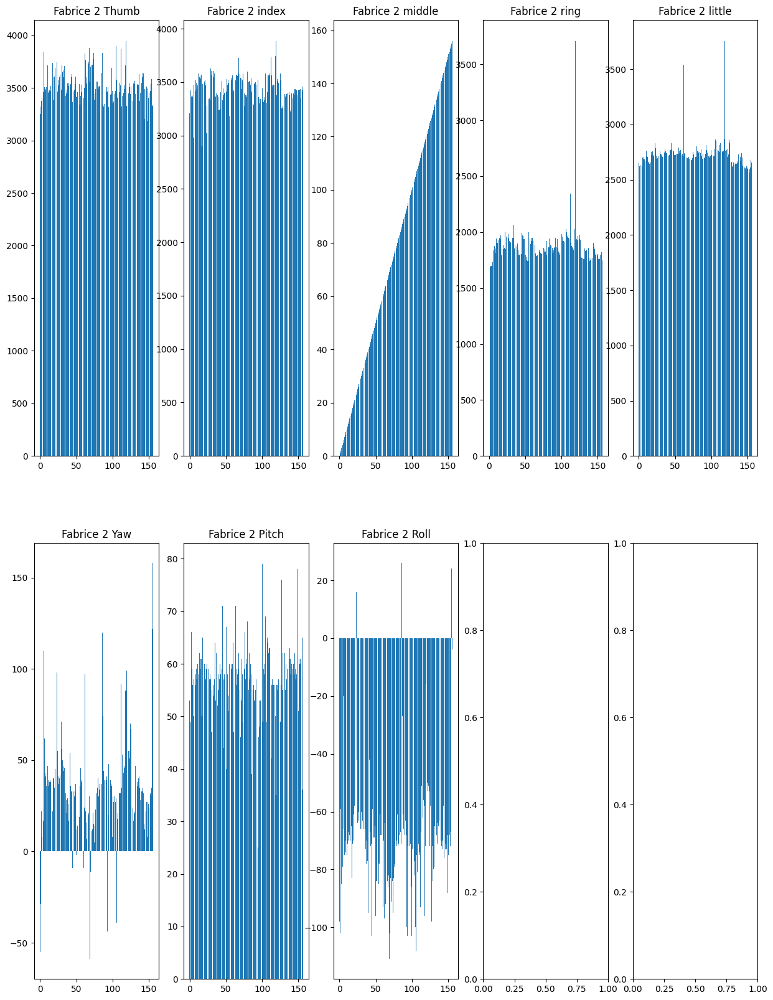

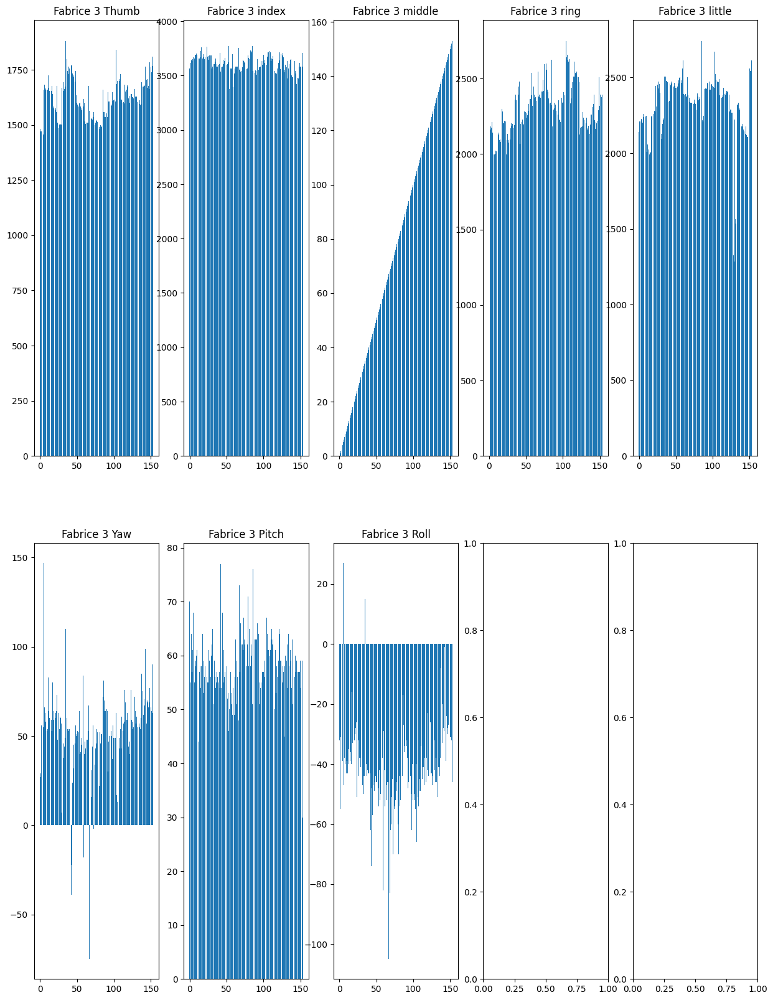

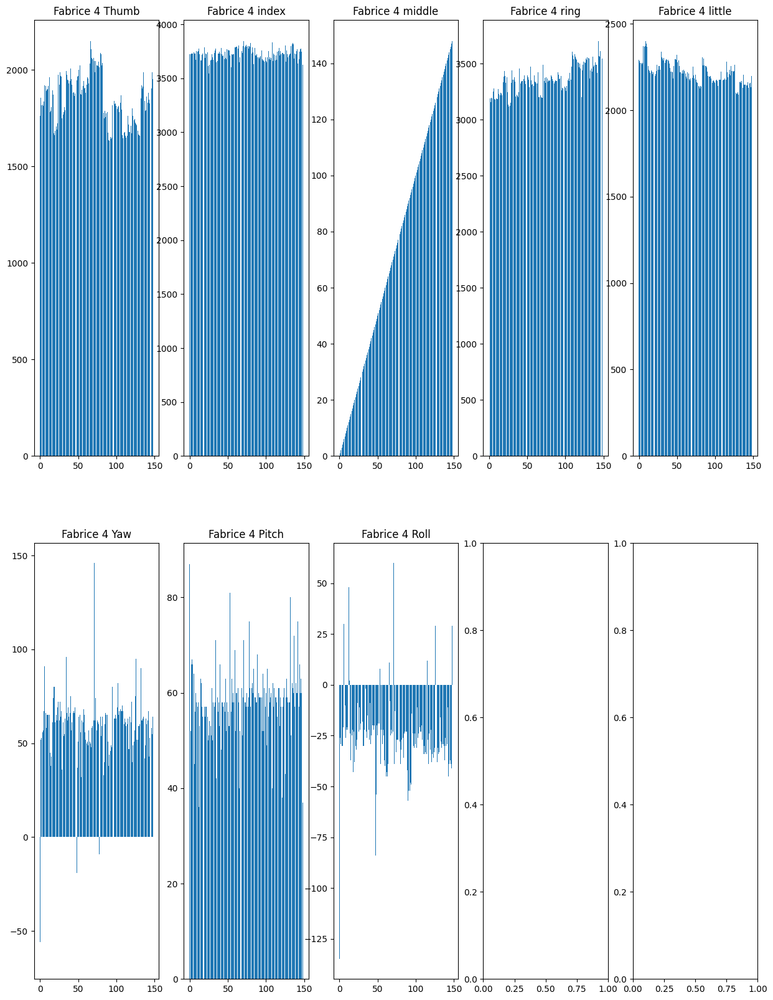

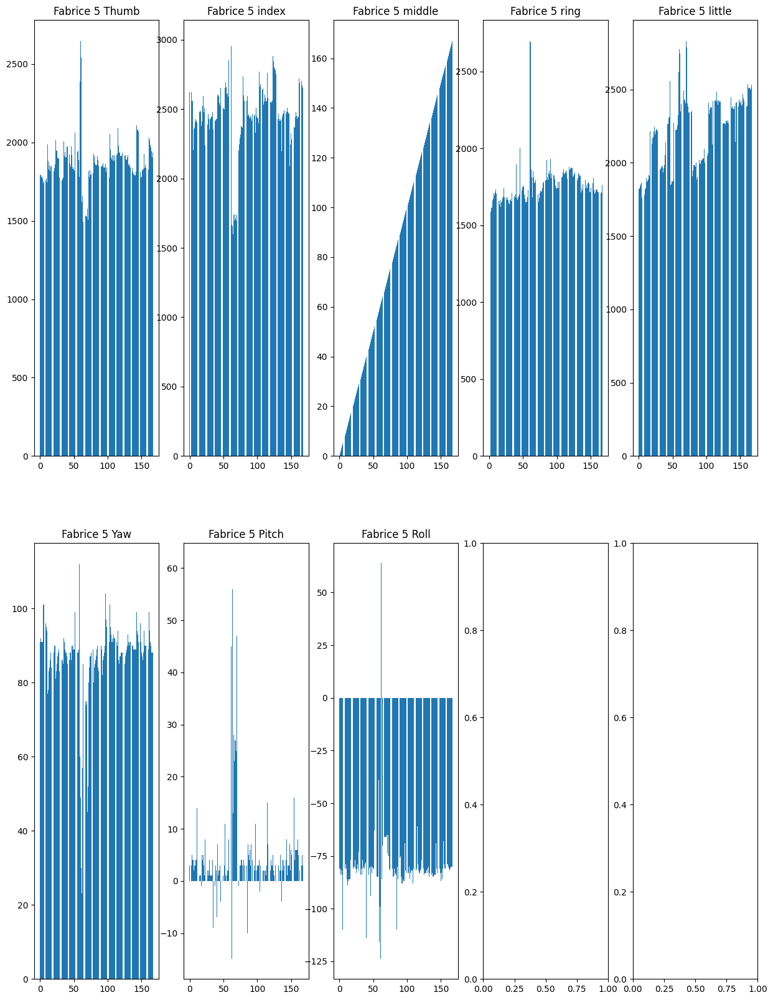

...

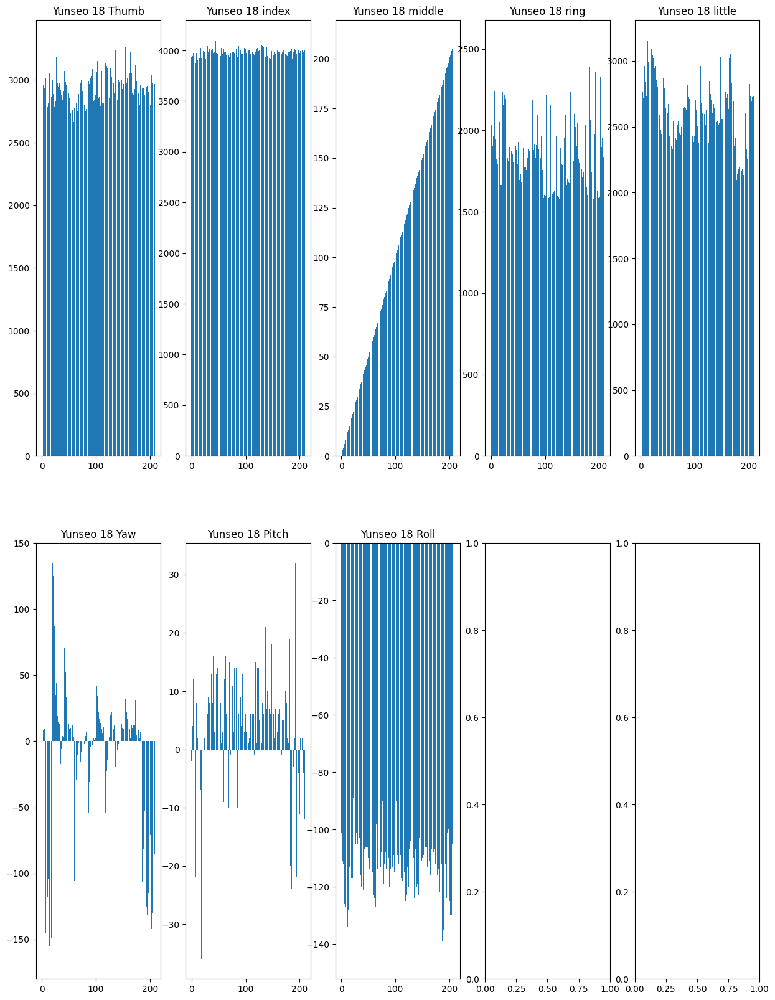

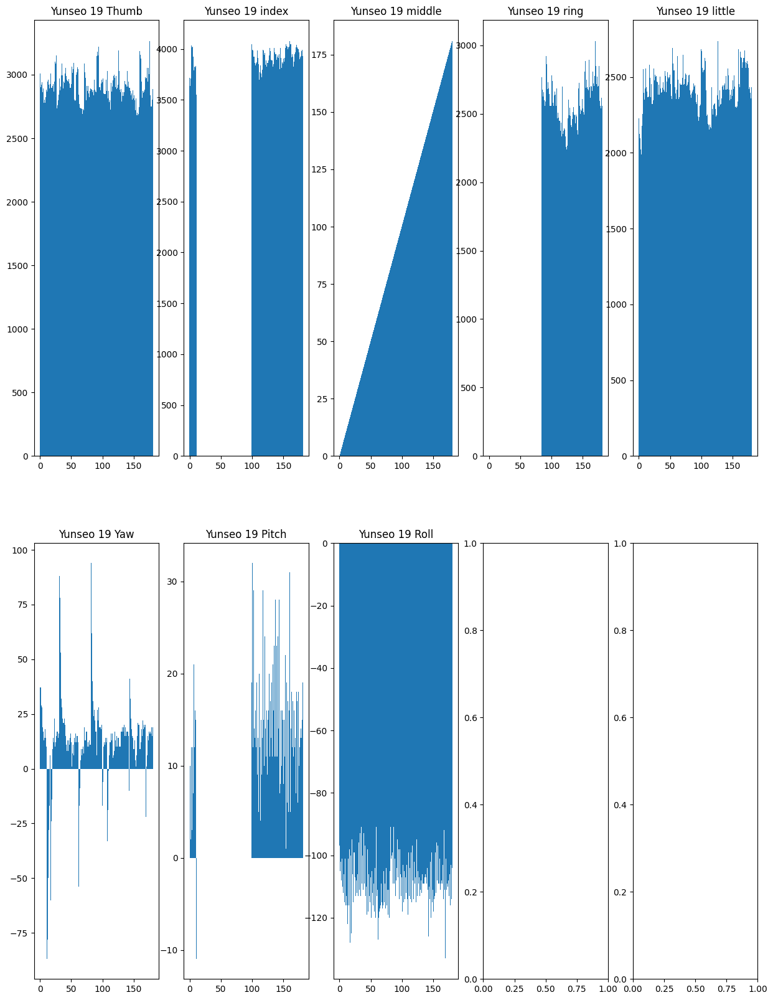

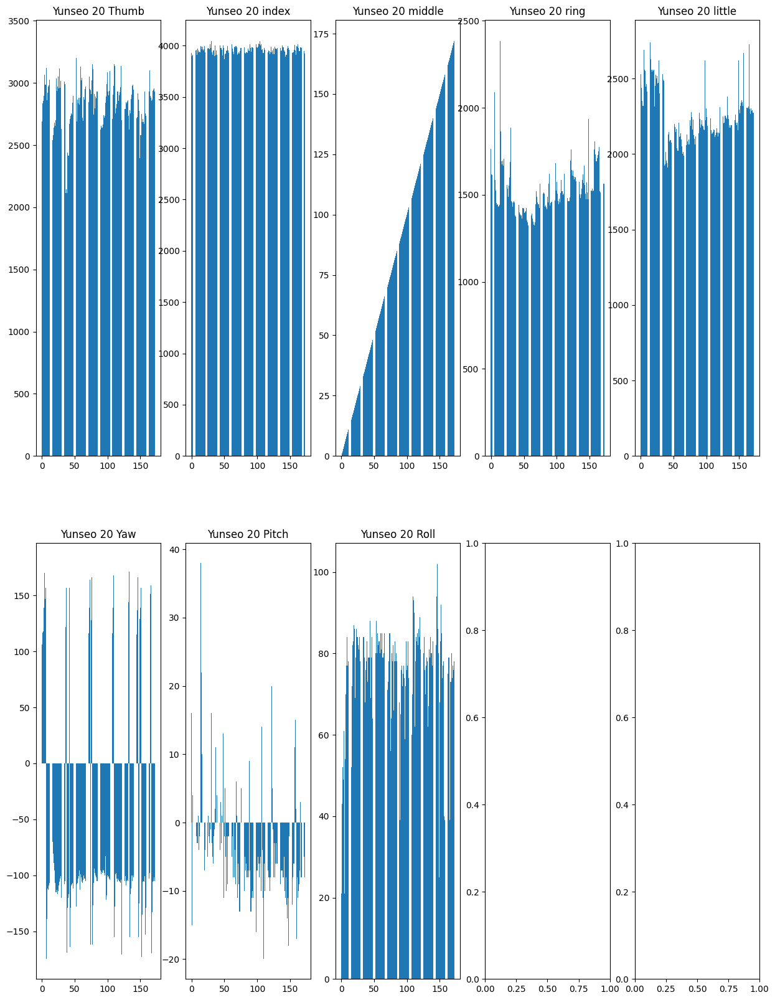

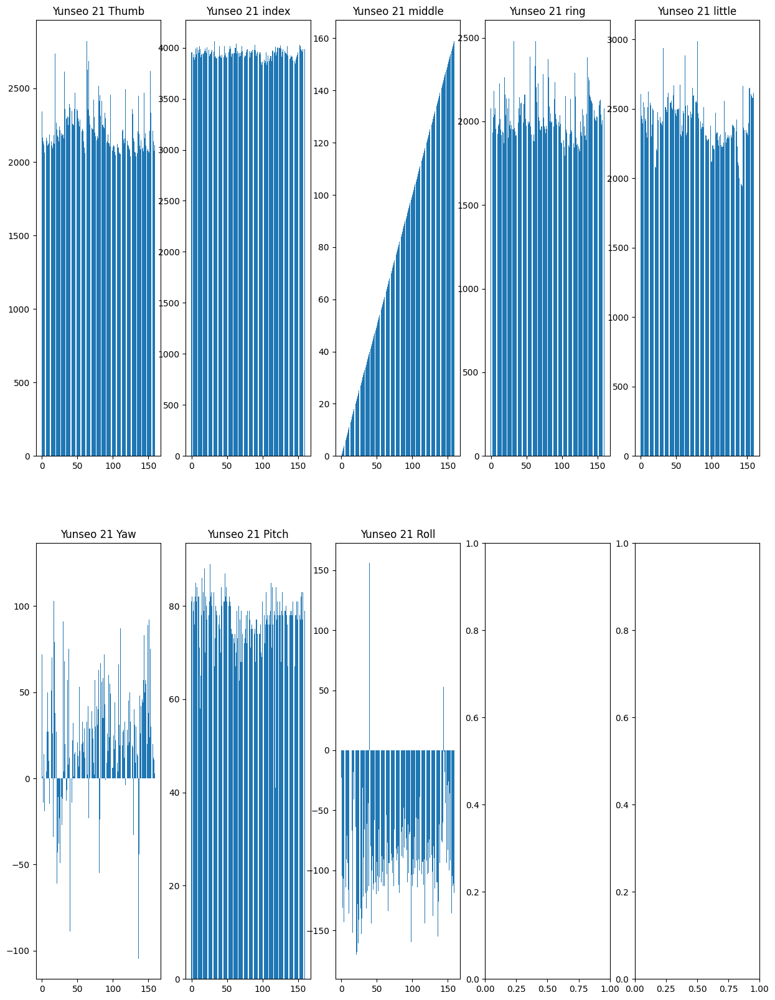

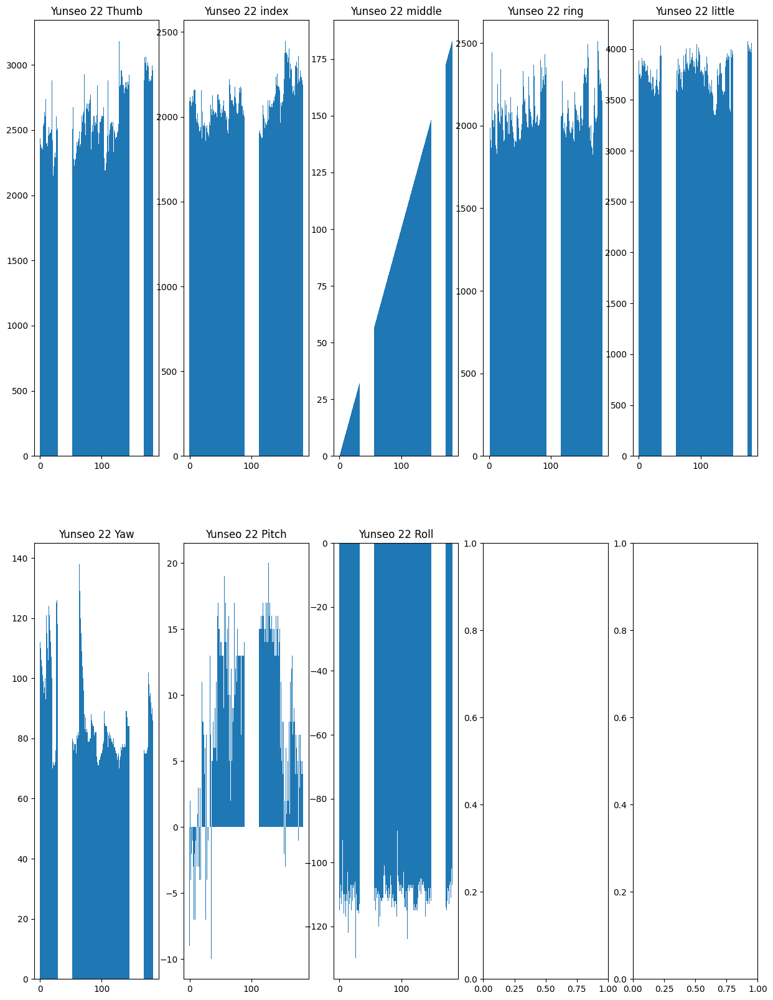

In [3]:
# 총 자음, 모음 개수
total_consonant_vowel_cnts = 22

# 자음 모음 diagram
class_diagram = [[] * total_consonant_vowel_cnts]

# 총 자음 모음 수만큼의 sheet
sheet_name_lst = [('ㄱ', 1), ('ㄴ', 2), ('ㄷ', 3), ('ㄹ', 4), ('ㅁ', 5), ('ㅂ', 6), 
                  ('ㅅ', 7), ('ㅇ', 8), ('ㅈ', 9), ('ㅊ', 10), ('ㅋ', 11), ('ㅍ', 12), 
                  ('ㅎ', 13), ('ㅏ', 14), ('ㅑ', 15), ('ㅓ', 16), ('ㅕ', 17), 
                  ('ㅗ', 18), ('ㅛ', 19), ('ㅜ', 20), ('ㅡ', 21), ('ㅣ', 22)]

# print(label_data_path.split('/'))
man_save_analysis_path = '/'.join(man_label_data_path.split('/')[:-2]) + '/Analysis/'
woman_save_analysis_path = '/'.join(woman_label_data_path.split('/')[:-2]) + '/Analysis/'

# print(save_analysis_path)
os.makedirs(man_save_analysis_path, exist_ok = True)
os.makedirs(woman_save_analysis_path, exist_ok = True)

# All Participants Valid data list
man_total_valid_datas_lst = []
man_total_valid_datas_dict = {}
woman_total_valid_datas_lst = []
woman_total_valid_datas_dict = {}
total_minimum_lst = []

# Visualize distribution of five fingers at all consonants and vowels that they are valid
for xlsx_idx, label_data_p in tqdm(enumerate(man_label_data_lst)):
    # print('Each person`s finger distribution')
    # print('label_data_p :', label_data_p)
    person_name = label_data_p.split('/')[-1].replace('.xlsx', '')
    # print('person name :', person_name, ', and type of person_name :', type(person_name))
    save_person_analysis = man_save_analysis_path + '/' + person_name.upper() + '/'
    if not os.path.isdir(save_person_analysis):
        os.makedirs(save_person_analysis)
    
    valid_datas_lst = []
    # Write each person's maximum and minimum cost of all fingers at all hangul character
    with open(save_person_analysis + person_name.upper() + '_Min_cost_haugul_characters.txt', 'w') as file:
        for sheet_num, (hangul_character, label_cost) in enumerate(sheet_name_lst):
            file.write('No {}-{}. {}\n'.format(xlsx_idx, sheet_num, hangul_character))
            person_data_sheet_total = pd.read_excel(label_data_p, sheet_name = sheet_num, 
                                                    header = 2)
            # Slicing the data -> trash file exist(First, Second row)
            person_data_sheet_total = person_data_sheet_total.iloc[:, 2:]
            # print(person_data_sheet_total.head())
            
            # print(person_name + '`s ' + hangul_character + ', and label cost : ' + str(label_cost))
            
            person_data_sheet_valid = person_data_sheet_total.loc[person_data_sheet_total[hangul_character] == label_cost]
            # print(person_data_sheet_valid.head())
            
            # Row index list ex) 0, 1, 2, 3, 4, ...
            # person_data_index = person_data_total.index
            # print(person_data_index)
            
            # Remove unnecessary characters and make costs to list
            thumb_lst = person_data_sheet_valid['Thumb'].to_list()
            thumb_x_lst = list(range(len(thumb_lst)))
            index_lst = person_data_sheet_valid['Index'].to_list()
            index_x_lst = list(range(len(index_lst)))
            middle_lst = person_data_sheet_valid['Middle'].to_list()
            middle_x_lst = list(range(len(middle_lst)))
            ring_lst = person_data_sheet_valid['Ring'].to_list()
            ring_x_lst = list(range(len(ring_lst)))
            little_lst = person_data_sheet_valid['Little'].to_list()
            little_x_lst = list(range(len(little_lst)))
            thumb_min = min(thumb_lst)
            index_min = min(index_lst)
            middle_min = min(middle_lst)
            ring_min = min(ring_lst)
            little_min = min(little_lst)
            total_minimum_lst.append([thumb_min, index_min, middle_min, ring_min, little_min])
            file.write(person_name + ' Thumb Minimum cost : ' + str(thumb_min) + '\n')
            file.write(person_name + ' Index Minimum cost : ' + str(index_min) + '\n')
            file.write(person_name + ' Middle Minimum cost : ' + str(middle_min) + '\n')
            file.write(person_name + ' Ring Minimum cost : ' + str(ring_min) + '\n')
            file.write(person_name + ' Little Minimum cost : ' + str(little_min) + '\n')
            
            yaw_lst = pd.to_numeric(person_data_sheet_valid['Yaw'], errors = 'coerce').to_list()
            yaw_x_lst = list(range(len(yaw_lst)))
            pitch_lst = pd.to_numeric(person_data_sheet_valid['Pitch'], errors = 'coerce').to_list()
            pitch_x_lst = list(range(len(pitch_lst)))
            roll_lst = pd.to_numeric(person_data_sheet_valid['Roll'], errors = 'coerce').to_list()
            roll_x_lst = list(range(len(roll_lst)))
            
            yaw_min, yaw_max = min(yaw_lst), max(yaw_lst)
            pitch_min, pitch_max = min(pitch_lst), max(pitch_lst)
            roll_min, roll_max = min(roll_lst), max(roll_lst)
            
            file.write(person_name + ' Yaw Minimum cost : ' +  str(yaw_min) + ', Yaw Maximum cost : ' + str(yaw_max) + '\n')
            file.write(person_name + ' Pitch Minimum cost : ' + str(pitch_min) + ', Pitch Maximum cost : ' + str(pitch_max) + '\n')
            file.write(person_name + ' Roll Minimum cost : ' + str(roll_min) + ', Roll Maximum cost : ' + str(roll_max) + '\n\n')            
            # Save Valid datas
            valid_datas_lst.append([thumb_lst, index_lst, middle_lst, ring_lst, little_lst, 
                                    yaw_lst, pitch_lst, roll_lst])
            
            fig, ax = plt.subplots(2, 5, figsize = (15, 20))
            ax[0, 0].bar(thumb_x_lst, thumb_lst)
            ax[0, 1].bar(index_x_lst, index_lst)
            ax[0, 2].bar(middle_x_lst, middle_x_lst)
            ax[0, 3].bar(ring_x_lst, ring_lst)
            ax[0, 4].bar(little_x_lst, little_lst)
            ax[1, 0].bar(yaw_x_lst, yaw_lst)
            ax[1, 1].bar(pitch_x_lst, pitch_lst)
            ax[1, 2].bar(roll_x_lst, roll_lst)
            
            ax[0, 0].set_title(person_name + ' ' + str(label_cost) + ' Thumb')
            ax[0, 1].set_title(person_name + ' ' + str(label_cost) + ' index')
            ax[0, 2].set_title(person_name + ' ' + str(label_cost) + ' middle')
            ax[0, 3].set_title(person_name + ' ' + str(label_cost) + ' ring')
            ax[0, 4].set_title(person_name + ' ' + str(label_cost) + ' little')
            ax[1, 0].set_title(person_name + ' ' + str(label_cost) + ' Yaw')
            ax[1, 1].set_title(person_name + ' ' + str(label_cost) + ' Pitch')
            ax[1, 2].set_title(person_name + ' ' + str(label_cost) + ' Roll')        
            
            plt.ioff()
            fig.savefig(save_person_analysis + str(sheet_num + 1) + '`s Five Finger Distribution')
        
    valid_datas = np.array(valid_datas_lst)
    # print(person_name + '`s valida data counts :', valid_datas.shape)
    man_total_valid_datas_lst.append(valid_datas_lst) 
    print()

man_total_valid_datas = np.array(man_total_valid_datas_lst)
print('Total valid data ndarray Shape :', man_total_valid_datas.shape)

# Visualize distribution of five fingers at all consonants and vowels that they are valid
for xlsx_idx, label_data_p in tqdm(enumerate(woman_label_data_lst)):
    # print('Each person`s finger distribution')
    # print('label_data_p :', label_data_p)
    person_name = label_data_p.split('/')[-1].replace('.xlsx', '')
    # print('person name :', person_name, ', and type of person_name :', type(person_name))
    save_person_analysis = woman_save_analysis_path + '/' + person_name.upper() + '/'
    if not os.path.isdir(save_person_analysis):
        os.makedirs(save_person_analysis)
    
    valid_datas_lst = []
    # Write each person's maximum and minimum cost of all fingers at all hangul character
    with open(save_person_analysis + person_name.upper() + '_Min_cost_haugul_characters.txt', 'w') as file:
        for sheet_num, (hangul_character, label_cost) in enumerate(sheet_name_lst):
            file.write('No {}-{}. {}\n'.format(xlsx_idx, sheet_num, hangul_character))
            person_data_sheet_total = pd.read_excel(label_data_p, sheet_name = sheet_num, 
                                                    header = 2)
            # Slicing the data -> trash file exist(First, Second row)
            person_data_sheet_total = person_data_sheet_total.iloc[:, 2:]
            # print(person_data_sheet_total.head())
            
            # print(person_name + '`s ' + hangul_character + ', and label cost : ' + str(label_cost))
            
            person_data_sheet_valid = person_data_sheet_total.loc[person_data_sheet_total[hangul_character] == label_cost]
            # print(person_data_sheet_valid.head())
            
            # Row index list ex) 0, 1, 2, 3, 4, ...
            # person_data_index = person_data_total.index
            # print(person_data_index)
            
            # Remove unnecessary characters and make costs to list
            thumb_lst = person_data_sheet_valid['Thumb'].to_list()
            thumb_x_lst = list(range(len(thumb_lst)))
            index_lst = person_data_sheet_valid['Index'].to_list()
            index_x_lst = list(range(len(index_lst)))
            middle_lst = person_data_sheet_valid['Middle'].to_list()
            middle_x_lst = list(range(len(middle_lst)))
            ring_lst = person_data_sheet_valid['Ring'].to_list()
            ring_x_lst = list(range(len(ring_lst)))
            little_lst = person_data_sheet_valid['Little'].to_list()
            little_x_lst = list(range(len(little_lst)))
            thumb_min = min(thumb_lst)
            index_min = min(index_lst)
            middle_min = min(middle_lst)
            ring_min = min(ring_lst)
            little_min = min(little_lst)
            total_minimum_lst.append([thumb_min, index_min, middle_min, ring_min, little_min])
            file.write(person_name + ' Thumb Minimum cost : ' + str(thumb_min) + '\n')
            file.write(person_name + ' Index Minimum cost : ' + str(index_min) + '\n')
            file.write(person_name + ' Middle Minimum cost : ' + str(middle_min) + '\n')
            file.write(person_name + ' Ring Minimum cost : ' + str(ring_min) + '\n')
            file.write(person_name + ' Little Minimum cost : ' + str(little_min) + '\n')
            
            yaw_lst = pd.to_numeric(person_data_sheet_valid['Yaw'], errors = 'coerce').to_list()
            yaw_x_lst = list(range(len(yaw_lst)))
            pitch_lst = pd.to_numeric(person_data_sheet_valid['Pitch'], errors = 'coerce').to_list()
            pitch_x_lst = list(range(len(pitch_lst)))
            roll_lst = pd.to_numeric(person_data_sheet_valid['Roll'], errors = 'coerce').to_list()
            roll_x_lst = list(range(len(roll_lst)))
            
            yaw_min, yaw_max = min(yaw_lst), max(yaw_lst)
            pitch_min, pitch_max = min(pitch_lst), max(pitch_lst)
            roll_min, roll_max = min(roll_lst), max(roll_lst)
            
            file.write(person_name + ' Yaw Minimum cost : ' +  str(yaw_min) + ', Yaw Maximum cost : ' + str(yaw_max) + '\n')
            file.write(person_name + ' Pitch Minimum cost : ' + str(pitch_min) + ', Pitch Maximum cost : ' + str(pitch_max) + '\n')
            file.write(person_name + ' Roll Minimum cost : ' + str(roll_min) + ', Roll Maximum cost : ' + str(roll_max) + '\n\n')            
            # Save Valid datas
            valid_datas_lst.append([thumb_lst, index_lst, middle_lst, ring_lst, little_lst, 
                                    yaw_lst, pitch_lst, roll_lst])
            
            fig, ax = plt.subplots(2, 5, figsize = (15, 20))
            ax[0, 0].bar(thumb_x_lst, thumb_lst)
            ax[0, 1].bar(index_x_lst, index_lst)
            ax[0, 2].bar(middle_x_lst, middle_x_lst)
            ax[0, 3].bar(ring_x_lst, ring_lst)
            ax[0, 4].bar(little_x_lst, little_lst)
            ax[1, 0].bar(yaw_x_lst, yaw_lst)
            ax[1, 1].bar(pitch_x_lst, pitch_lst)
            ax[1, 2].bar(roll_x_lst, roll_lst)
            
            ax[0, 0].set_title(person_name + ' ' + str(label_cost) + ' Thumb')
            ax[0, 1].set_title(person_name + ' ' + str(label_cost) + ' index')
            ax[0, 2].set_title(person_name + ' ' + str(label_cost) + ' middle')
            ax[0, 3].set_title(person_name + ' ' + str(label_cost) + ' ring')
            ax[0, 4].set_title(person_name + ' ' + str(label_cost) + ' little')
            ax[1, 0].set_title(person_name + ' ' + str(label_cost) + ' Yaw')
            ax[1, 1].set_title(person_name + ' ' + str(label_cost) + ' Pitch')
            ax[1, 2].set_title(person_name + ' ' + str(label_cost) + ' Roll')        
            plt.ioff()
            fig.savefig(save_person_analysis + str(sheet_num + 1) + '`s Five Finger Distribution')
        
    valid_datas = np.array(valid_datas_lst)
    # print(person_name + '`s valida data counts :', valid_datas.shape)
    woman_total_valid_datas_lst.append(valid_datas_lst) 
    print()

woman_total_valid_datas = np.array(woman_total_valid_datas_lst)
print('Total valid data ndarray Shape :', woman_total_valid_datas.shape)
total_min_arr = np.array(total_minimum_lst)
print('Each Finger`s Minimum cost of total_minimum_lst :', min(total_minimum_lst))
print('Total Minimum cost of total_minimum_lst :', min(min(total_minimum_lst)))
print('total_min_arr Shape :', total_min_arr.shape)

In [4]:
print('Total Minimum cost of total_minimum_lst :', min(min(total_minimum_lst)))

Total Minimum cost of total_minimum_lst : 1227.0
